# PRÁCTICA 1 - TIV

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib

from skimage import data, util, exposure, color
from PIL import Image
print(type(Image))

<class 'module'>


### 1) Leer y Visualizar las imagenes

<class 'str'>
1662162106288


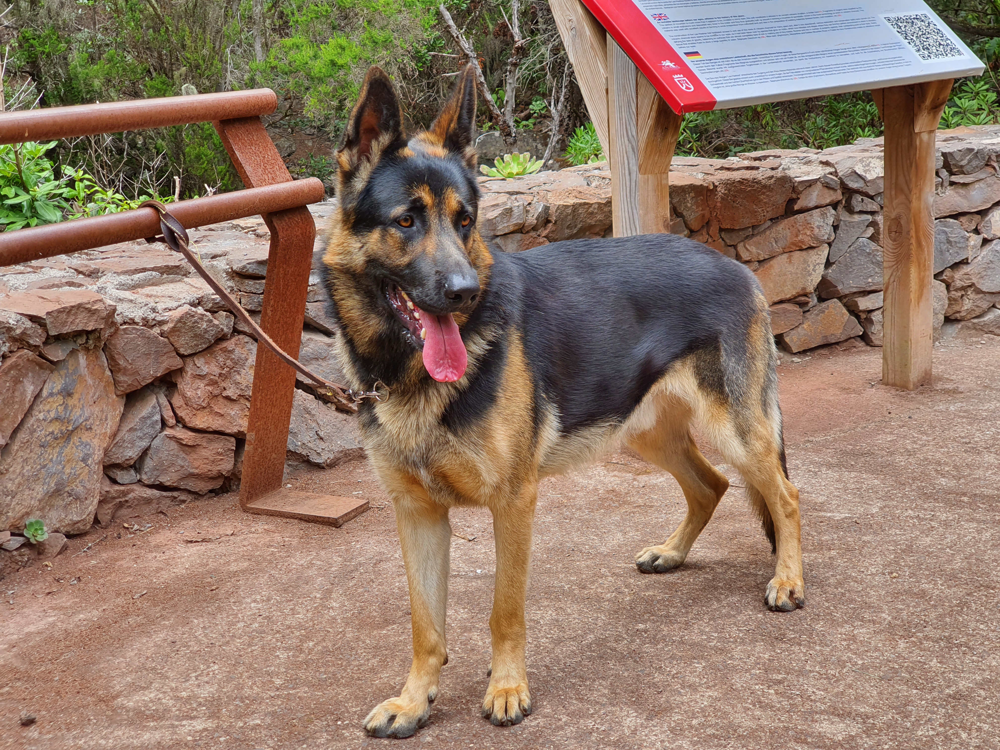

<class 'str'>
1662161739984


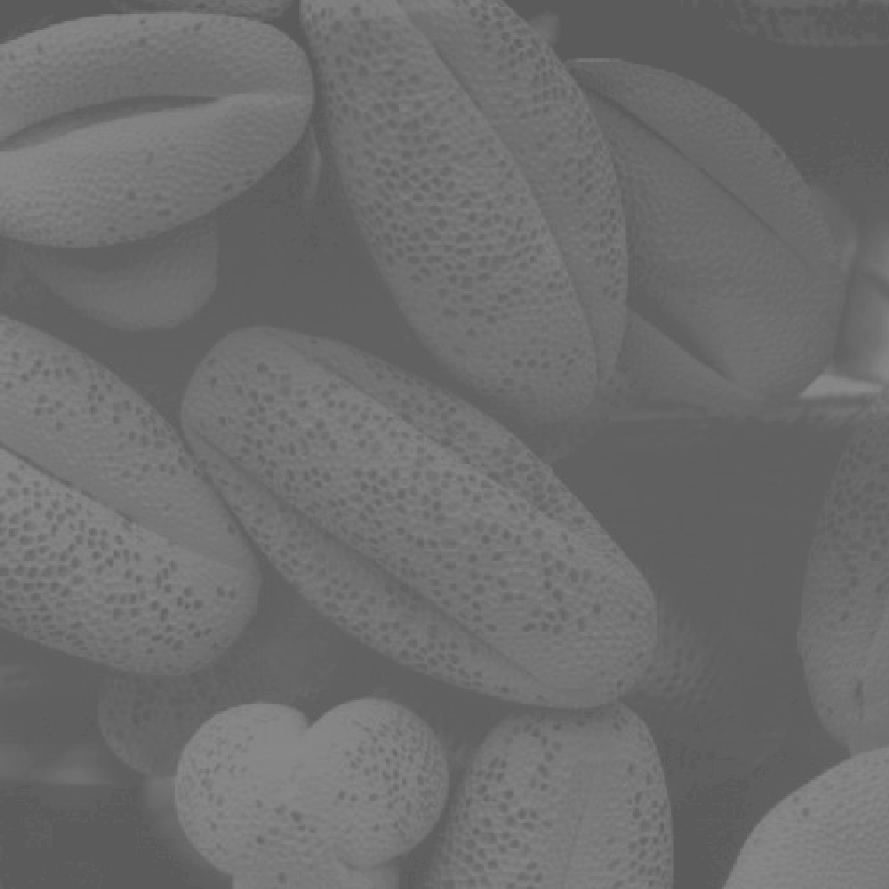

In [217]:

"""
file = 'images/breastXray.tif'
print(type(file))
print(id(file))

Imgmamografia  = Image.open(file)
display(Imgmamografia)

"""

file = 'images/PerroBoston.jpg'
print(type(file))
print(id(file))

Imgperro  = Image.open(file)
display(Imgperro)

"""
file = 'images/skeleton.tif'
print(type(file))
print(id(file))

Imgskeleton  = Image.open(file)
display(Imgskeleton)



file = 'images/washed_aerial.tif'
print(type(file))
print(id(file))

ImgCiudad  = Image.open(file)
display(ImgCiudad)

"""

file = 'images/washed_pollen.tif'
print(type(file))
print(id(file))

ImgPolen  = Image.open(file)
display(ImgPolen)


### 2) Una vez representamos las imágenes, vamos a representar los siguientes valores:

a) Principales estadísticos, tales como valores máximo, mínimo, rango, valor 
medio, desviación típica, varianza,, coeficiente de variación, valor mediano,
cuartiles, rango intercuartil, rango medio intercuartil.

A continuación se representan los parámetros de la imagen. Para decidir que imagen ver, habría que comentar todas menos la que te interese ver; como vemos a continuación, se muestra la imagen "ImgPolen".

Tipo de datos:  uint8
Tamaño de imagen (filas, columnas):  (800, 500)
Númro de píxels:  400000


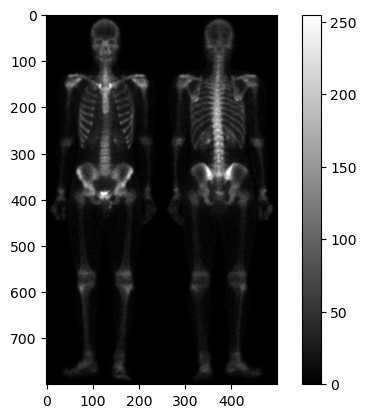

In [218]:
#img = np.array(Imgmamografia) 
#img = np.array(Imgperro)
img = np.array(Imgskeleton)
#img = np.array(ImgCiudad)
#img = np.array(ImgPolen)

print('Tipo de datos: ', img.dtype)
print('Tamaño de imagen (filas, columnas): ', img.shape)
print('Númro de píxels: ', img.size)
plt.imshow(img,cmap='gray');
plt.colorbar();

In [219]:
print('Mímimo: ', img.min(), '\tMáximo: ', img.max(), '\tRango: ', img.max()-img.min())
print('Media: ', img.mean(), '\tDesviación típica: ', img.std(), '\tVarianza: ', img.var(), 
      '\nCoeficiente de variación', img.std()/img.mean(), )

Mímimo:  0 	Máximo:  255 	Rango:  255
Media:  17.2210775 	Desviación típica:  29.338301113714703 	Varianza:  860.7359122389935 
Coeficiente de variación 1.7036274944883503


In [220]:
img_q = np.quantile(img, (0.25, 0.5, 0.75))
print('1er cuantil (Q1): ', img_q[0], '\tMediana (Q2): ', img_q[1], '\t3er cuantil (Q3): ', img_q[2],
     '\nRango intercuantil (IQR): ', img_q[2]-img_q[0], '\tRango medio intercuantil: ', (img_q[0]+img_q[2])/2,
     '\nBigote inferior (Q1 - 1.5 IQR): ', (img_q[0]*1.5)-(img_q[2]-img_q[0]),
     '\nBigote superior (Q3 + 1.5 IQR): ', (img_q[2]*1.5)+(img_q[2]-img_q[0]))

1er cuantil (Q1):  0.0 	Mediana (Q2):  4.0 	3er cuantil (Q3):  22.0 
Rango intercuantil (IQR):  22.0 	Rango medio intercuantil:  11.0 
Bigote inferior (Q1 - 1.5 IQR):  -22.0 
Bigote superior (Q3 + 1.5 IQR):  55.0


### b) Histograma y función de distribución cumulativa

Valor mínimo:  0 	Valor máximo:  255


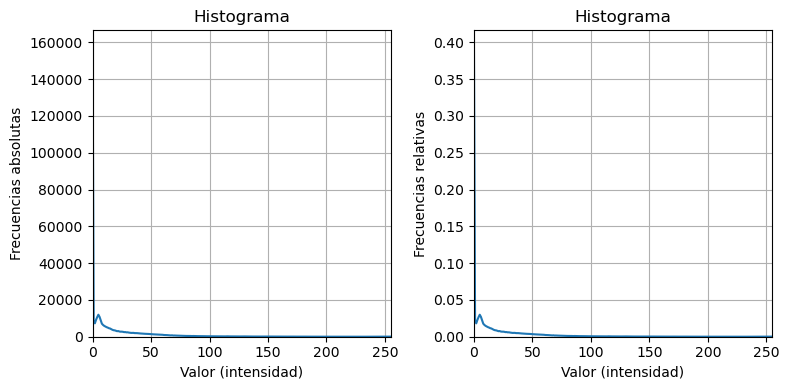

In [221]:
plt.figure(figsize=(8, 4))


img_hist, bins = exposure.histogram(img, normalize=False)
plt.subplot(121)
plt.plot(bins, img_hist)
plt.axis([0,255, 0, 1.01*img_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias absolutas')
plt.grid()


img_hist, bins = exposure.histogram(img, normalize=True)

plt.subplot(122)
plt.plot(bins, img_hist)
plt.axis([0,255, 0, 1.01*img_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

plt.tight_layout()

print('Valor mínimo: ', img.min(), '\tValor máximo: ', img.max())

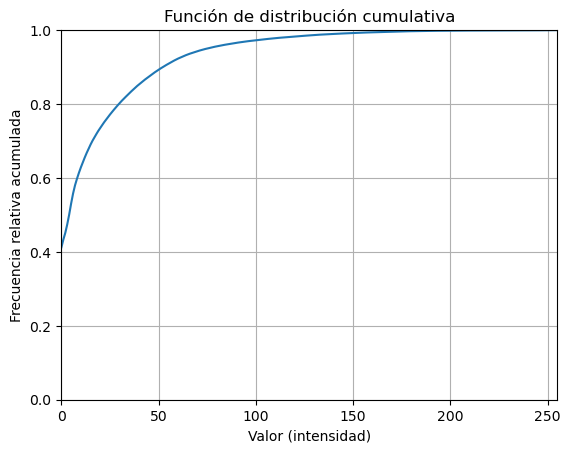

In [222]:
img_cdf, bins_cdf = exposure.cumulative_distribution(img)

plt.plot(bins_cdf, img_cdf)
plt.axis([0,255, 0, 1])
plt.title('Función de distribución cumulativa')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencia relativa acumulada')
plt.grid()

c) Diagrama de dispersión (caja bigote)

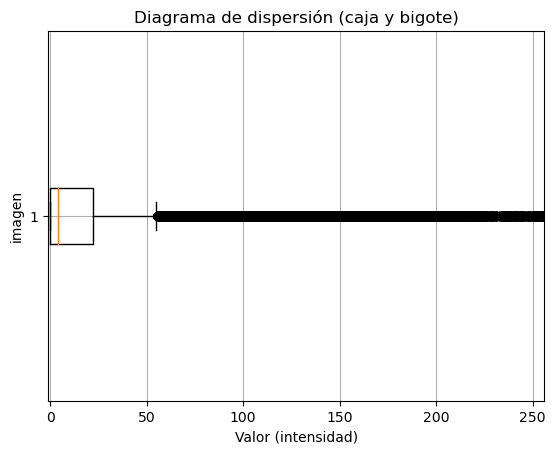

In [223]:
plt.boxplot(img.flatten(), vert=False)
plt.xlim([-1, 256])
plt.title('Diagrama de dispersión (caja y bigote)')
plt.xlabel('Valor (intensidad)')
plt.ylabel('imagen')
plt.grid()

#### d) Hay que describir razonadamente los resultados estadísticos a la vista de las imágenes

En primer lugar
    
    

#### e) Para la imagen en color, el análisis hay que hacerlo para los canales (R, G, B) y (H,S,V)

Tipo de datos:  uint8
Tamaño de imagen (filas, columnas):  (3024, 4032, 3)
Númro de píxels:  36578304


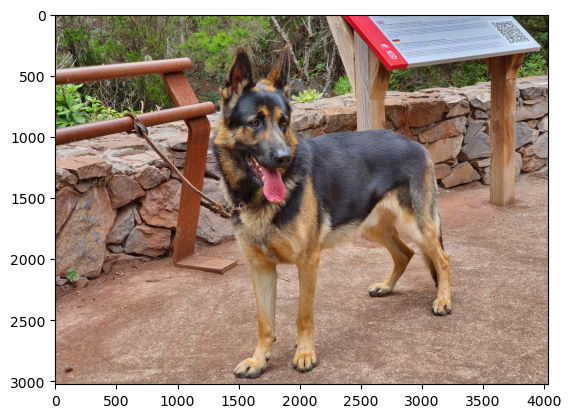

In [224]:
img_RGB = np.array(Imgperro) #Trabajamos la imagen en los canales RGB
     
print('Tipo de datos: ', img_RGB.dtype)
print('Tamaño de imagen (filas, columnas): ', img_RGB.shape)
print('Númro de píxels: ', img_RGB.size)
plt.imshow(img_RGB);

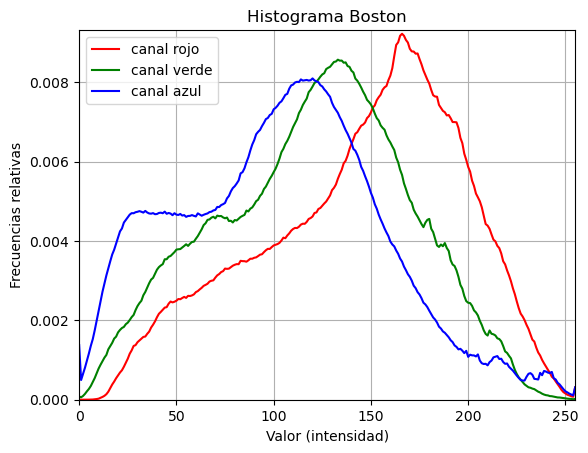

In [225]:
#Vemos la representación de los canales RGB en el histograma
img_hist, bins = exposure.histogram(img_RGB, channel_axis=2, normalize=True)
M = img_hist.max()

plt.plot(bins, img_hist[0,:],'r', label='canal rojo')
plt.plot(bins, img_hist[1,:],'g', label='canal verde')
plt.plot(bins, img_hist[2,:],'b', label='canal azul')

plt.axis([0,255, 0, 1.01*img_hist.max()])
plt.legend()
plt.title('Histograma Boston')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

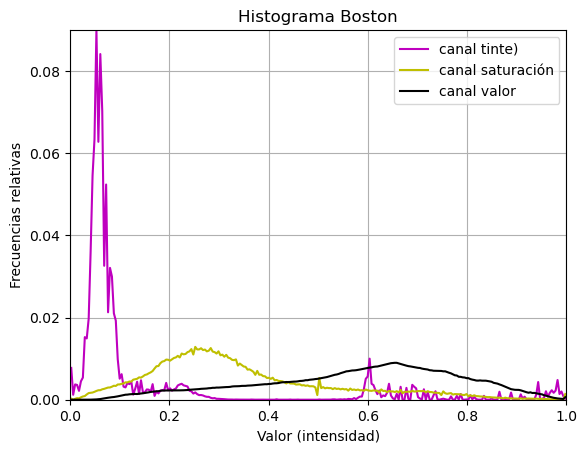

In [226]:
#  Ahora vamos a visualizar los componentes de la imagen en el espacio de color HSV
#  Para ello, partimos de la división de canales del espacio RGB y representamos en un histograma de la
# misma forma

img_hsv = color.rgb2hsv(img_RGB)

img_hist, bins = exposure.histogram(img_hsv, channel_axis=2, normalize=True)

plt.plot(bins, img_hist[0,:],'m', label='canal tinte)')
plt.plot(bins, img_hist[1,:],'y', label='canal saturación')
plt.plot(bins, img_hist[2,:],'k', label='canal valor')

plt.axis([0,1, 0, img_hist.max()])
plt.legend()
plt.title('Histograma Boston')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

##### Para el resto de estadísticos de la imagen, los representaremos con el mismo código que para las imágenes en blanco y negro pero con el espacio de color RGB

In [227]:
print('Mímimo: ', img_RGB.min(), '\tMáximo: ', img_RGB.max(), '\tRango: ', img_RGB.max()-img_RGB.min())
print('Media: ', img_RGB.mean(), '\tDesviación típica: ', img_RGB.std(), '\tVarianza: ', img_RGB.var(), 
      '\nCoeficiente de variación', img_RGB.std()/img_RGB.mean(), )
print(img_RGB.dtype)

Mímimo:  0 	Máximo:  255 	Rango:  255
Media:  123.00402079877733 	Desviación típica:  53.4611035864513 	Varianza:  2858.0895966812764 
Coeficiente de variación 0.43462891082161037
uint8


In [228]:
img_q = np.quantile(img_RGB, (0.25, 0.5, 0.75))
print('1er cuantil (Q1): ', img_q[0], '\tMediana (Q2): ', img_q[1], '\t3er cuantil (Q3): ', img_q[2],
     '\nRango intercuantil (IQR): ', img_q[2]-img_q[0], '\tRango medio intercuantil: ', (img_q[0]+img_q[2])/2,
     '\nBigote inferior (Q1 - 1.5 IQR): ', (img_q[0]*1.5)-(img_q[2]-img_q[0]),
     '\nBigote superior (Q3 + 1.5 IQR): ', (img_q[2]*1.5)+(img_q[2]-img_q[0]))

1er cuantil (Q1):  84.0 	Mediana (Q2):  126.0 	3er cuantil (Q3):  163.0 
Rango intercuantil (IQR):  79.0 	Rango medio intercuantil:  123.5 
Bigote inferior (Q1 - 1.5 IQR):  47.0 
Bigote superior (Q3 + 1.5 IQR):  323.5


C:\Users\maria\anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


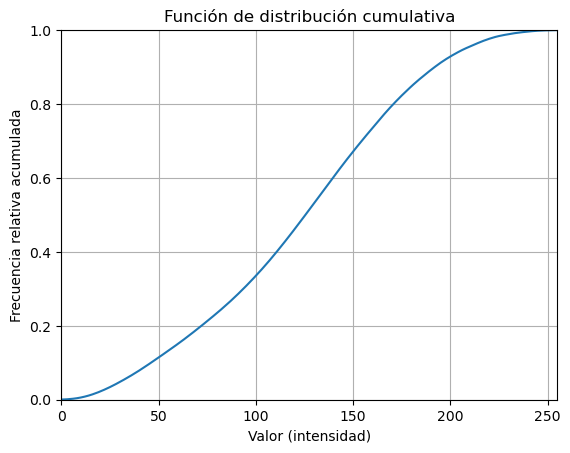

In [229]:
img_cdf, bins_cdf = exposure.cumulative_distribution(img_RGB)

plt.plot(bins_cdf, img_cdf)
plt.axis([0,255, 0, 1])
plt.title('Función de distribución cumulativa')
plt.xlabel('Valor (intensidad)')

plt.ylabel('Frecuencia relativa acumulada')
plt.grid()

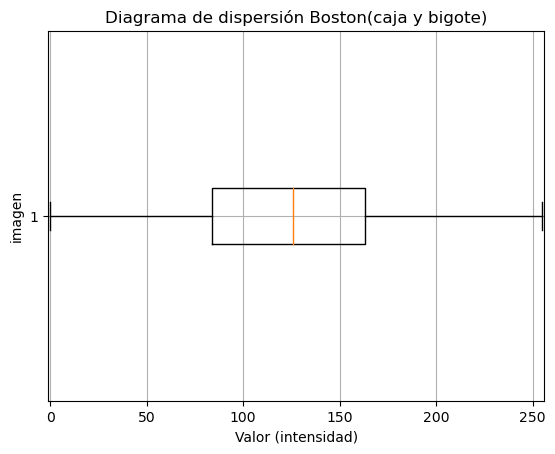

In [230]:
# Diagrama de dispersión
plt.boxplot(img_RGB.flatten(), vert=False)
plt.xlim([-1, 256])
plt.title('Diagrama de dispersión Boston(caja y bigote)')
plt.xlabel('Valor (intensidad)')
plt.ylabel('imagen')
plt.grid()

### 3) Mejorar la exposición (brillo y contraste) de cada imagen en niveles de grises 

Esto se hará para obtener una “buena” impresión visual. En cada caso hay que indicar qué se
pretende y cómo se consigue

##### *Para poder visualizar todas las imagenes, tendremos que marcar y desmarcar cada una de las imagenes.*

In [233]:
#img = np.array(Imgmamografia) 
#img = np.array(Imgperro)
#img = np.array(Imgskeleton)
#img = np.array(ImgCiudad)
img = np.array(ImgPolen)

print('Tipo de datos: ', img.dtype)
print('Tamaño de imagen (filas, columnas): ', img.shape)
print('Número de píxels: ', img.size)
print('Imagen: \nValor mínimo: ', img.min(), '\tValor máximo: ', img.max())
print('Valor mediano: ', img.mean())

Tipo de datos:  uint8
Tamaño de imagen (filas, columnas):  (889, 889)
Número de píxels:  790321
Imagen: 
Valor mínimo:  91 	Valor máximo:  138
Valor mediano:  109.08651168322744


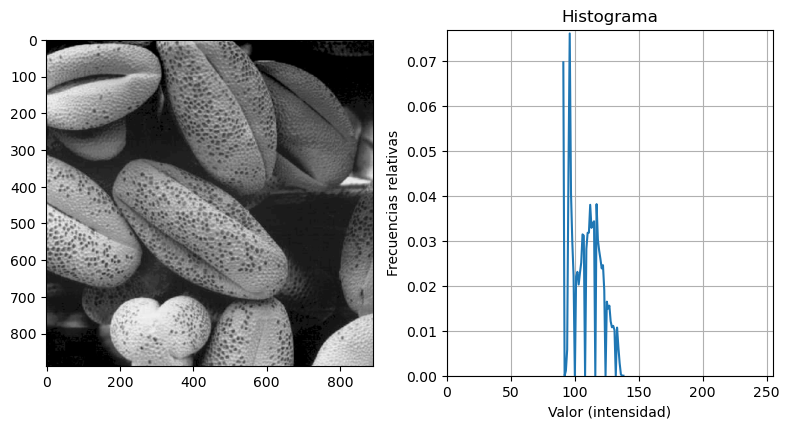

In [234]:
img_hist, bins = exposure.histogram(img, normalize=True)

plt.figure(figsize=(8, 8))

plt.subplot(221)
plt.imshow(img, cmap='gray')

plt.subplot(222)
plt.plot(bins, img_hist)
plt.axis([0,255, 0, 1.01*img_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

plt.tight_layout()

Aunque las imágenes estén en blanco y negro, como podemos observar en el histograma, se representan los rangos de contraste en las imagen. Al ser en dos colores, en las imagenes en blanco y negro  el contraste es siempre notorio.
Esto se debe a que podemos encontrar un valor totalmente negro y otro blanco, y está claro que no puede haber valores más contrarios que el blanco y el negro.

In [235]:
exposure.is_low_contrast(img,  fraction_threshold=0.85)

True

Si probamos con esta linea y cambiamos el porcentaje en el threshold, podremos comprobar el rango de contraste de la imagen, siendo este del 0% al 100%. 
Groso modo, el unmbral de bajo contraste estará fijado en utilizar al menos el x% del rango dinámico que en la función salga true.

A continuación, definiremos los rangos en los que el nivel de blancos y negros, mejoran el contraste y brillo en las imágenes.
Al estar el código dividido y no estár metido en funciones, este cambio se tendría que realizar a mano.
A continuación adjunto los valores adecuados según mi persepción que harían de cada imagen un cambio notorio a mejor.
- Imgmamografia -> Bl = 25, Wl = 180
- Imgperro-> Bl = 25, Wl = 220
- Imgskeleton -> Bl = 5, Wl = 200
- ImgCiudad -> Bl= 105, Wl = 240
- ImgPolen-> Bl= 60 Wl= 190



In [236]:
# Definición de la transformación

Mi = 255

Bl= 60 
Wl= 190

L = (Bl + Wl)/2
W = Wl - Bl

#L = 128
#W = 256

#Bl = L - W/2
#Wl = L + W/2

m = Mi/W
b = -Mi*(L/W - 0.5)

print('Nivel (L): ', L, '\tVentana (W): ', W)
print('Nivel de negro: ', Bl, '\tNivel de Blanco: ', Wl)
print('m = ', m, 'b = ', b)


Nivel (L):  125.0 	Ventana (W):  130
Nivel de negro:  60 	Nivel de Blanco:  190
m =  1.9615384615384615 b =  -117.6923076923077


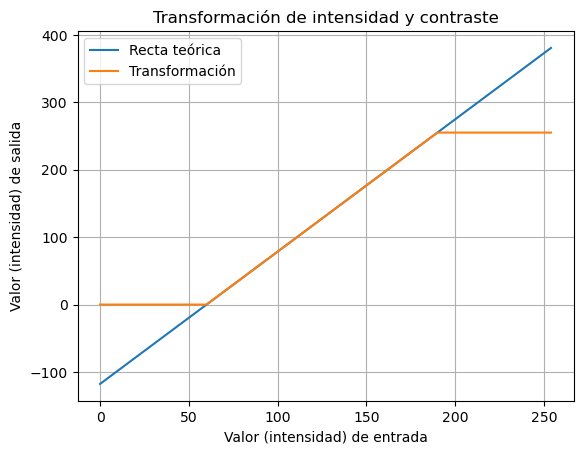

In [237]:
x = np.arange((min(Bl, 0)), max(Wl, Mi))
y = m*x +b

y_transf = y.copy()
y_transf[y_transf<0] = 0
y_transf[y_transf>Mi] = Mi

plt.plot(x,y, label='Recta teórica')
plt.plot(x, y_transf, label='Transformación')

plt.legend()
plt.title('Transformación de intensidad y contraste')
plt.xlabel('Valor (intensidad) de entrada')
plt.ylabel('Valor (intensidad) de salida')
plt.grid()

In [238]:
img_float = util.img_as_float(img)*Mi

img_float = img_float*m + b
img_float[img_float<0]  = 0
img_float[img_float>Mi] = Mi

img_transf = util.img_as_ubyte(img_float/Mi)

print('Tipo de datos: ', img_transf.dtype)
print('Tamaño de imagen (filas, columnas): ', img_transf.shape)
print('Número de píxels: ', img_transf.size)
print('Imagen: \nValor mínimo: ', img_transf.min(), '\tValor máximo: ', img_transf.max())
print('Valor mediano: ', img_transf.mean())

Tipo de datos:  uint8
Tamaño de imagen (filas, columnas):  (889, 889)
Número de píxels:  790321
Imagen: 
Valor mínimo:  61 	Valor máximo:  153
Valor mediano:  96.32976600647079


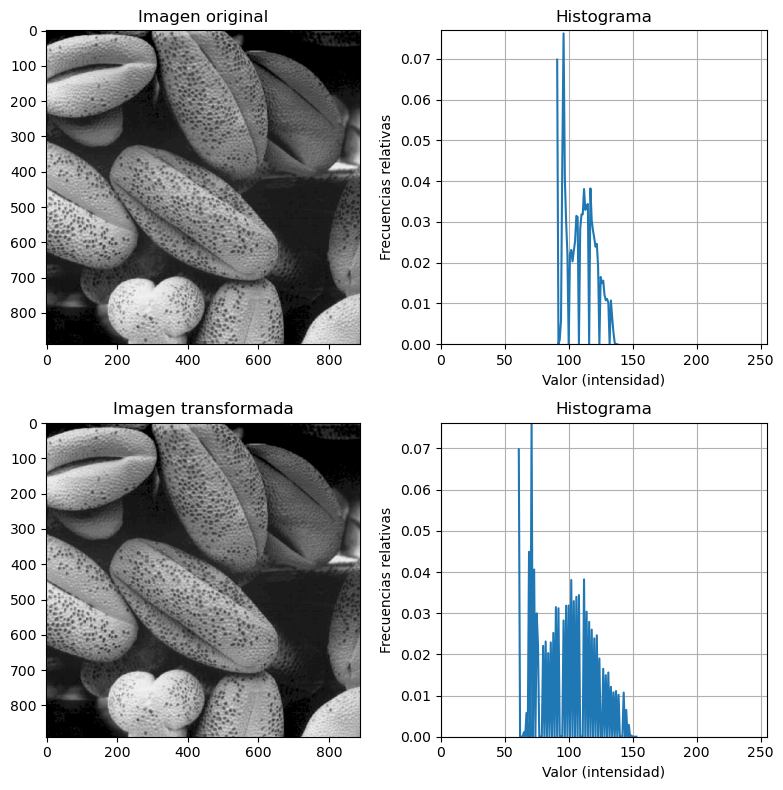

In [239]:
img_hist, bins = exposure.histogram(img, normalize=True)

plt.figure(figsize=(8, 8))

plt.subplot(221)
plt.imshow(img, cmap='gray')
plt.title('Imagen original')

plt.subplot(222)
plt.plot(bins, img_hist)
plt.axis([0,255, 0, 1.01*img_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()


img_hist, bins = exposure.histogram(img_transf, normalize=True)

plt.subplot(223)
plt.imshow(img_transf, cmap='gray')
plt.title('Imagen transformada')

plt.subplot(224)
plt.plot(bins, img_hist)
plt.axis([0,255, 0, img_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

plt.tight_layout()

### 4) Para las imagenes en blanco y negro, vamos a hacer un proceso diferente. 
Vamos a sacar el negativo para visualizarlas con una intensidad diferente. Invertiremos la imagen 
y veremos el contraste.

Tipo de datos:  uint8
Tamaño de imagen (filas, columnas):  (889, 889)
Númro de píxels:  790321
Imagen: 
Valor mínimo:  91 	Valor máximo:  138
Imagen inversa: 
Valor mínimo:  117 	Valor máximo:  164


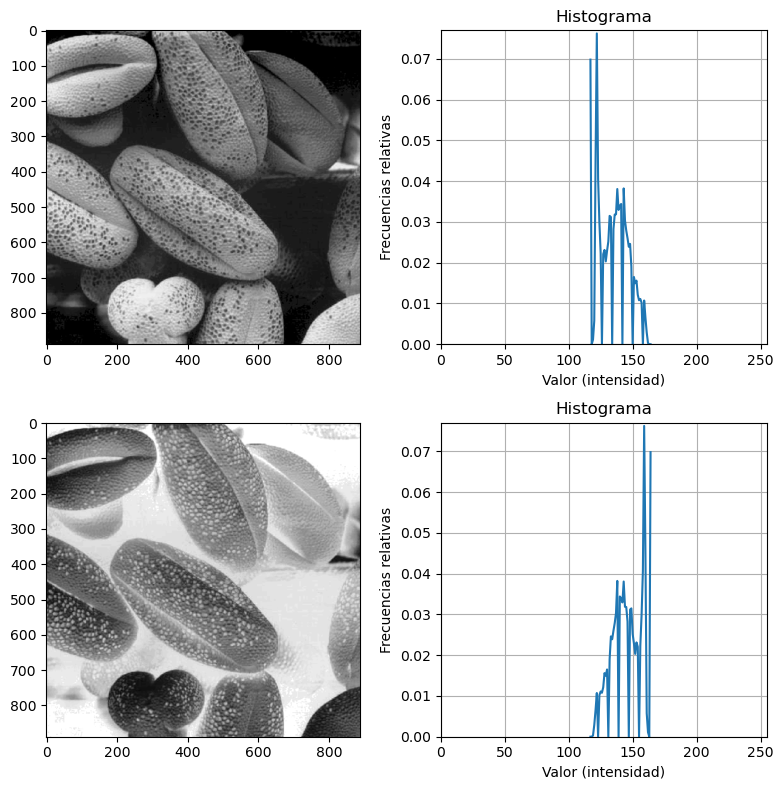

In [240]:
#img = np.array(Imgmamografia) 
#img = np.array(Imgskeleton)
#img = np.array(ImgCiudad)
img = np.array(ImgPolen)
img_inv = util.invert(img)
print('Tipo de datos: ', img.dtype)
print('Tamaño de imagen (filas, columnas): ', img.shape)
print('Númro de píxels: ', img.size)
print('Imagen: \nValor mínimo: ', img.min(), '\tValor máximo: ', img.max())
print('Imagen inversa: \nValor mínimo: ', img_inv.min(), '\tValor máximo: ', img_inv.max())

img_hist, bins = exposure.histogram(img, normalize=True)
img_inv_hist, bins = exposure.histogram(img_inv, normalize=True)

plt.figure(figsize=(8, 8))

plt.subplot(221)
plt.imshow(img, cmap='gray')

plt.subplot(222)
plt.plot(bins, img_hist)
plt.axis([0,255, 0, 1.01*img_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

plt.subplot(223)
plt.imshow(img_inv, cmap='gray')

plt.subplot(224)
plt.plot(bins, img_inv_hist)
plt.axis([0,255, 0, 1.01*img_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

plt.tight_layout()

### 5) Para la imagen en color, las transformaciones deben aplicarse solo sobre el canal de luminancia



Mímimo:  0 	Máximo:  255
uint8


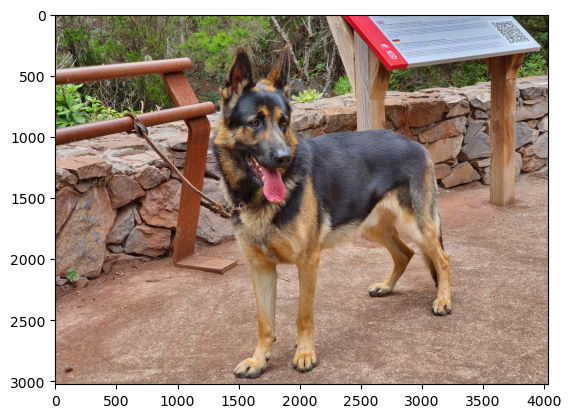

In [241]:
plt.imshow(img_RGB)

print('Mímimo: ', img_RGB.min(), '\tMáximo: ', img_RGB.max(), )
print(img_RGB.dtype)

Mímimo:  0.011764705882352941 	Máximo:  1.0
float64


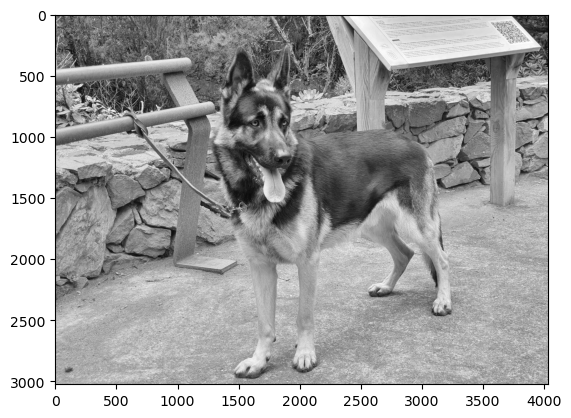

In [242]:
# Cogemos la variable declarada img_hsv que ya está en el espacio de color HSV y modificamos la luminancia, el canal V

#plt.imshow(img_hsv); tenemos que tener en cuenta que en hsv la imagen es flotante

img_v = img_hsv[:,:,2]
plt.imshow(img_v, cmap='gray')

print('Mímimo: ', img_v.min(), '\tMáximo: ', img_v.max(), )
print(img_v.dtype)


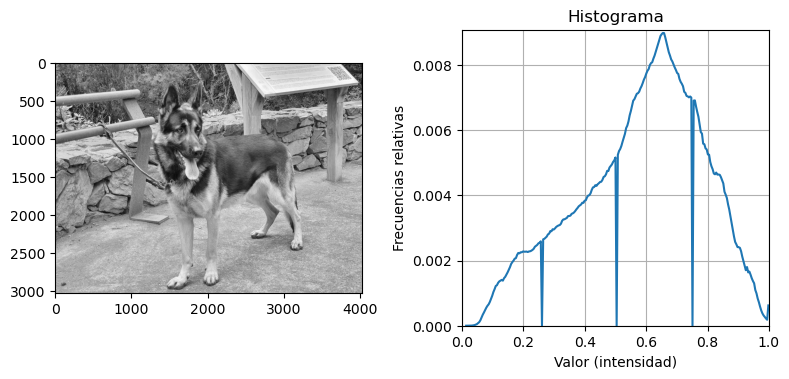

In [243]:
img_hist, bins = exposure.histogram(img_v, normalize=True)

plt.figure(figsize=(8, 7))

plt.subplot(221)
plt.imshow(img_v, cmap='gray')
           
plt.subplot(222)
plt.plot(bins, img_hist)
plt.axis([0,1, 0, 1.01*img_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

plt.tight_layout()

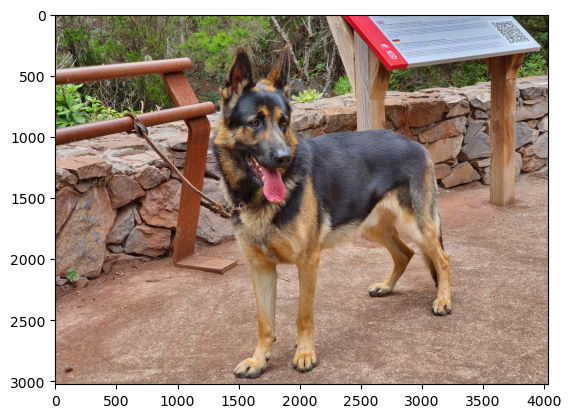

In [244]:
img_hsv[:,:,2] = img_v
img_RGB_nuevo = color.hsv2rgb(img_hsv)

plt.imshow(img_RGB_nuevo)

In [245]:
exposure.is_low_contrast(img_v,  fraction_threshold=0.5)


#Con esta funcion comprobamos que el contraste de la imagen es bastante alto, en este caso el 
# unmbral de bajo contraste está fijado en utilizar al menos el 50% del rango dinámico de la imagen)

True

In [246]:
Mi = 255

Bl = 105
Wl = 165

L = (Bl + Wl)/2
W = Wl - Bl

#L = 128
#W = 256

#Bl = L - W/2
#Wl = L + W/2

m = Mi/W
b = -Mi*(L/W - 0.5)

print('Nivel (L): ', L, '\tVentana (W): ', W)
print('Nivel de negro: ', Bl, '\tNivel de Blanco: ', Wl)
print('m = ', m, 'b = ', b)


Nivel (L):  135.0 	Ventana (W):  60
Nivel de negro:  105 	Nivel de Blanco:  165
m =  4.25 b =  -446.25


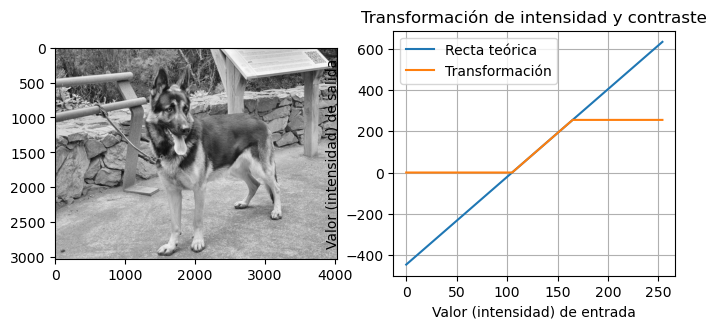

In [247]:
x = np.arange((min(Bl, 0)), max(Wl, Mi))
y = m*x +b

y_transf = y.copy()
y_transf[y_transf<0] = 0
y_transf[y_transf>Mi] = Mi

plt.figure(figsize=(8, 7))
plt.subplot(221)
plt.imshow(img_v, cmap='gray' )

plt.subplot(222)
plt.plot(x,y, label='Recta teórica')
plt.plot(x, y_transf, label='Transformación')
plt.legend()
plt.title('Transformación de intensidad y contraste')
plt.xlabel('Valor (intensidad) de entrada')
plt.ylabel('Valor (intensidad) de salida')
plt.grid()


In [248]:
img_float = util.img_as_float(img_v)*Mi

img_float = img_float*m + b
img_float[img_float<0]  = 0
img_float[img_float>Mi] = Mi

img_transf = util.img_as_ubyte(img_float/Mi)

print('Tipo de datos: ', img_transf.dtype)
print('Tamaño de imagen (filas, columnas): ', img_transf.shape)
print('Número de píxels: ', img_transf.size)
print('Imagen: \nValor mínimo: ', img_transf.min(), '\tValor máximo: ', img_transf.max())
print('Valor mediano: ', img_transf.mean())

Tipo de datos:  uint8
Tamaño de imagen (filas, columnas):  (3024, 4032)
Número de píxels:  12192768
Imagen: 
Valor mínimo:  0 	Valor máximo:  255
Valor mediano:  160.5931094563597


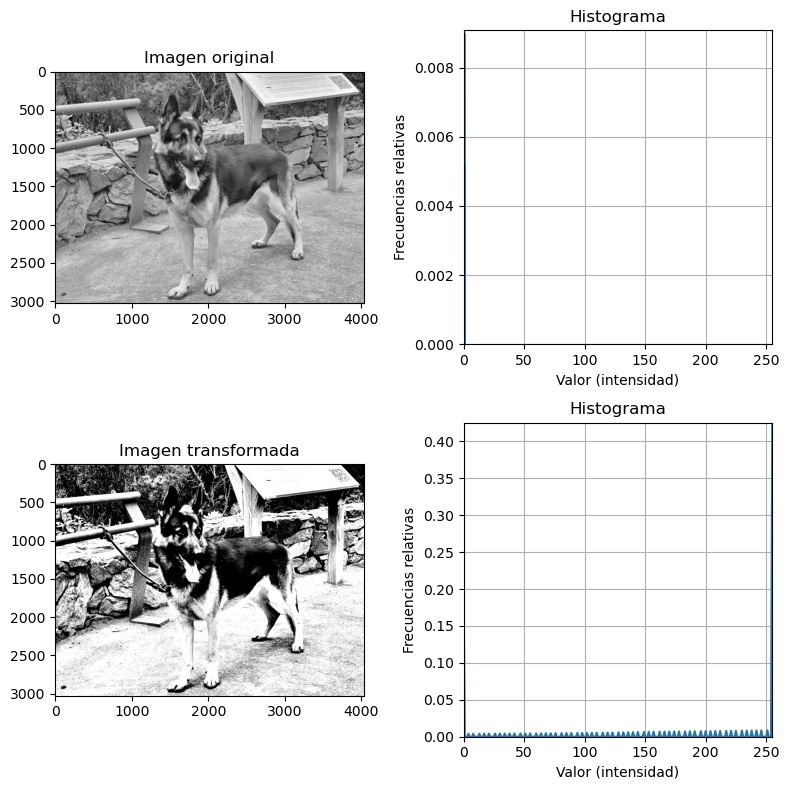

In [249]:
img_hist, bins = exposure.histogram(img_v, normalize=True)

plt.figure(figsize=(8, 8))

plt.subplot(221)
plt.imshow(img_v, cmap='gray')
plt.title('Imagen original')

plt.subplot(222)
plt.plot(bins, img_hist)
plt.axis([0,255, 0, 1.01*img_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()


img_hist, bins = exposure.histogram(img_transf, normalize=True)

plt.subplot(223)
plt.imshow(img_transf, cmap='gray')
plt.title('Imagen transformada')

plt.subplot(224)
plt.plot(bins, img_hist)
plt.axis([0,255, 0, img_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

plt.tight_layout()

### 6) Generar máscaras que permitan extraer zonas de interés de cada de las imágenes

##### Para la máscara de boston, intentaré resaltar los tonos rojizos de la imagen dejando los tonos más oscuros más apagados

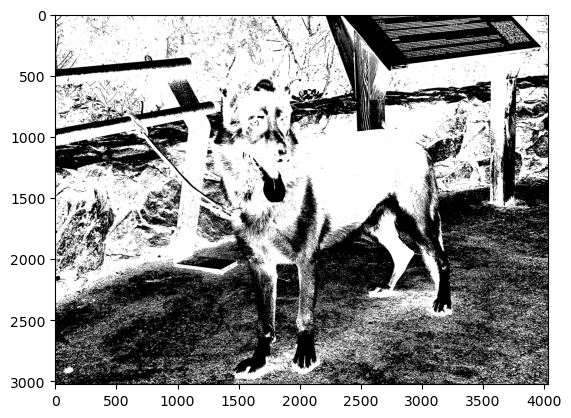

In [208]:
th_1, th_2 = 20, 160
mask=np.logical_and(img_RGB[:,:,0] > th_1, img_RGB[:,:,0] < th_2)
plt.imshow(mask, cmap='gray')

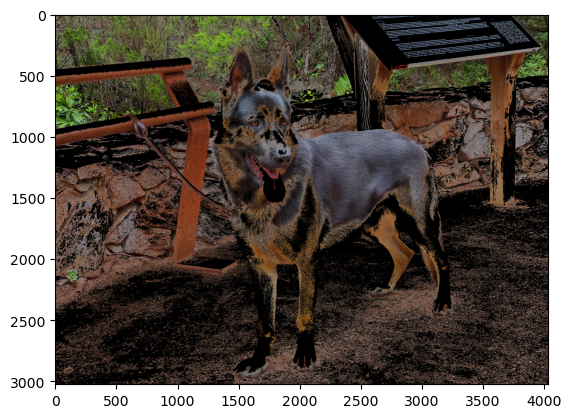

In [209]:
mask2 = mask[..., np.newaxis]

mask_multichannel = np.concatenate((mask2, mask2, mask2), axis=2)

plt.imshow(np.multiply(mask_multichannel,img_RGB))

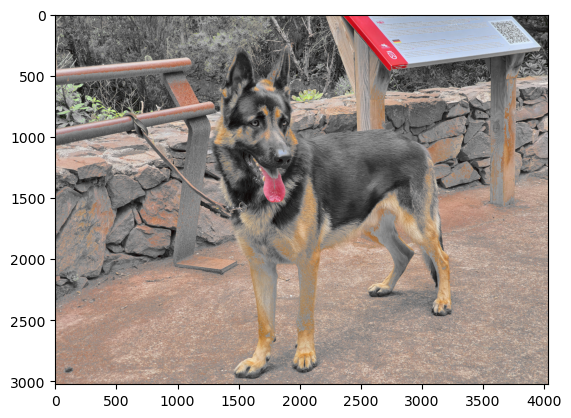

In [210]:

img_hsv2 = img_hsv.copy()

img_hsv2[mask,1] = 0

img_RGB2 = color.hsv2rgb(img_hsv2)

plt.imshow(img_RGB2);

##### Ahora haré la máscara de una de las imagenes en blanco y negro

### 7) Desaturar zonas de la imagen en color para realzar otras utilizando máscaras

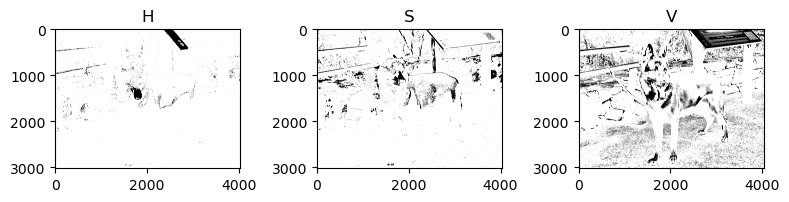

In [211]:
th_h1, th_h2 = 0.00, 0.95
th_s1, th_s2 = 0.1, 0.9
th_v1, th_v2 = 0.2, 0.83

mask_h = np.logical_and(img_hsv[:,:,0] >= th_h1, img_hsv[:,:,0] <= th_h2)
mask_s = np.logical_and(img_hsv[:,:,1] >= th_s1, img_hsv[:,:,1] <= th_s2)
mask_v = np.logical_and(img_hsv[:,:,2] >= th_v1, img_hsv[:,:,2] <= th_v2)

mask = np.logical_and(np.logical_and(mask_h, mask_s), mask_v)

plt.figure(figsize=(8, 4))

plt.subplot(131)
plt.imshow(mask_h, cmap='gray')
plt.title('H')

plt.subplot(132)
plt.imshow(mask_s, cmap='gray')
plt.title('S')

plt.subplot(133)
plt.imshow(mask_v, cmap='gray')
plt.title('V')

plt.tight_layout()

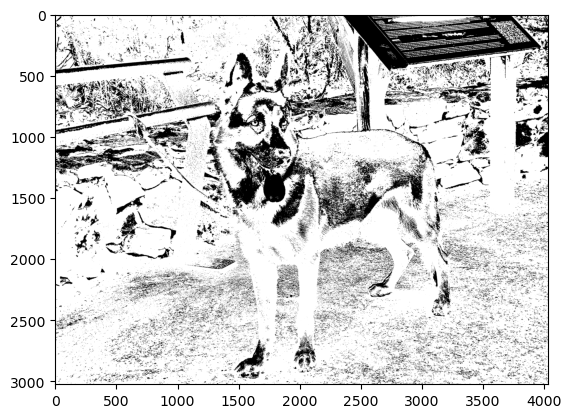

In [212]:
plt.imshow(mask,  cmap='gray')

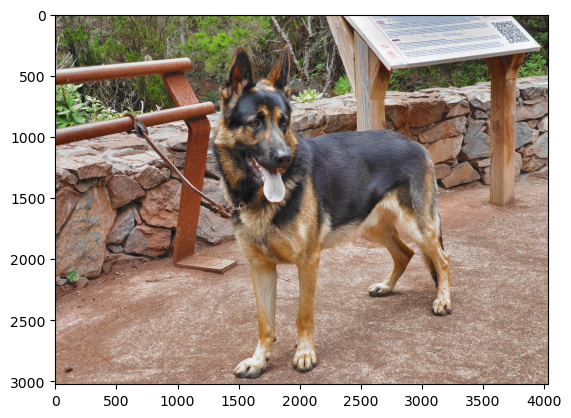

In [213]:
img_hsv2 = img_hsv.copy()

img_hsv2[np.logical_not(mask),1 ] = 0

img_RGB2 = color.hsv2rgb(img_hsv2)

plt.imshow(img_RGB2)

El objetivo a conseguir, es mantener el color en toda la imagen a excepción de la lengua de Boston. Por ello he conseguido sacar  en la máscara solo los valores más rojos de la imagen, como la lengua o el cartel de fondo. Esto se ha conseguido principalmente modificando el canal H y de V, el S de saturación, está casi al maximo (entre 0 y 1)